<a href="https://colab.research.google.com/github/MathRunner7/ZeeRecommender/blob/main/Zee_Recommender_Systems.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# A. Problem Statement and Data loading

## 0. Introduction

**What is Zee and It's Recommender Systems?**

Zee Recommender Systems represents an ambitious venture by Zee to enhance
user experience through personalized movie recommendations. Here, focus is on leveraging user ratings and similarities among users to create a robust, personalized movie recommender system. With the help of a comprehensive dataset of movie ratings, user demographics, and movie details, Zee aims to develop a system that can accurately predict user preferences and suggest movies accordingly. The insights gained from this system are expected to drive user engagement, increase satisfaction, and foster a more intuitive user experience.

**Purpose of this case study**

Ccase study offers an opportunity to delve into the complex and highly
relevant field of recommender systems, a cornerstone of modern AI-driven
platforms. It will help to explore collaborative filtering techniques, both item-based and user-based, and understand their applications in real-world scenarios. The project will cover a range of concepts including Pearson Correlation, Cosine Similarity, and Matrix Factorization, providing a comprehensive learning experience in building recommender systems. We will gain hands-on experience in building as well as evaluating these systems, honing skills that are highly sought after in the field of data science and machine learning.

**Data Dictionary:** There are three `.dat` files given

1. **zee-users.dat:**
  * Format: UserID::Gender::Age::Occupation::Zip-code
  * Provides demographic information about the users, including gender, age
group, occupation, and zip code
  * Demographic data is voluntarily provided by users and varies in accuracy
and completeness
  * UserIDs range between 1 and 6040
  * Gender is denoted by a "M" for male and "F" for female
  * Age is chosen from the following ranges:
   *1: "Under 18", 18: "18-24", 25: "25-34", 35: "35-44", 45: "45-49", 50: "50-55" and 56: "56+"
  * Occupation is chosen from the following choices:
    * 0: "other" or not specified
    * 1: "academic/educator"
    * 2: "artist"
    * 3: "clerical/admin"
    * 4: "college/grad student"
    * 5: "customer service"
    * 6: "doctor/health care"
    * 7: "executive/managerial"
    * 8: "farmer"
    * 9: "homemaker"
    * 10: "K-12 student"
    * 11: "lawyer"
    * 12: "programmer"
    * 13: "retired"
    * 14: "sales/marketing"
    * 15: "scientist"
    * 16: "self-employed"
    * 17: "technician/engineer"
    * 18: "tradesman/craftsman"
    * 19: "unemployed"
    * 20: "writer"
2. **zee-movies.dat:**
  * Format: MovieID::Title::Genres
  * Lists movie titles alongside their respective genres
  * Genres are categorized into multiple types like Action, Comedy, Drama,
etc., and are pipe-separated
  * MovieIDs range between 1 and 3952
  * Titles are identical to titles provided by the IMDB (including year of release)
  * Genres are pipe-separated and are selected from the following genres:
    * Action/Adventure/Animation/Children's/Comedy/Crime/Documentary/Drama/Fantasy/Film-Noir/Horror/Musical/Mystery/Romance/Sci-Fi/Thriller/War/Western
3. **zee-ratings.dat:**
  * Format: UserID::MovieID::Rating::Timestamp
  * Contains user ratings for movies on a 5-star scale (Whole-star rating only)
  * Includes a timestamp (in seconds) representing when the rating was given
  * Each user has rated at least 20 movies

## 1. Definition of problem

**Objective:** Purpose of this case study is to build three different recommendation system models based on pearson correlation, cosine simmilarity and matrix factorization.

In [ ]:
# Import Basic libraries
import pandas as pd
import numpy as np
import pickle
import re

# Import Visualization libraries
import plotly.graph_objs as go
import plotly.express as px
from plotly.subplots import make_subplots
import matplotlib.pyplot as plt
import seaborn as sns

# Import Performance Metrics
from sklearn.metrics import mean_squared_error as mse, mean_absolute_percentage_error as mape

# Ignore warnings
import warnings
warnings.filterwarnings('ignore')

In [ ]:
# Download Zee Users file
!gdown 1jFCWhWVgMqh26nHDWRZPkKd5halbhEko

# Download Zee Movies file
!gdown 18mSD21dVwsvaRMwJSlqa3AXICY4lLF90

# Download Zee Ratings file
!gdown 1gn9MG3JA-bYqn_vw26B0IOV5nHW2mqjg

Downloading...
From: https://drive.google.com/uc?id=1jFCWhWVgMqh26nHDWRZPkKd5halbhEko
To: /content/zee-users.dat
100% 134k/134k [00:00<00:00, 4.79MB/s]
Downloading...
From: https://drive.google.com/uc?id=18mSD21dVwsvaRMwJSlqa3AXICY4lLF90
To: /content/zee-movies.dat
100% 171k/171k [00:00<00:00, 5.70MB/s]
Downloading...
From: https://drive.google.com/uc?id=1gn9MG3JA-bYqn_vw26B0IOV5nHW2mqjg
To: /content/zee-ratings.dat
100% 24.6M/24.6M [00:00<00:00, 79.8MB/s]


In [ ]:
import chardet

with open('zee-users.dat', 'rb') as file:
    raw_data = file.read()
    print(f'Encoding of users file is {chardet.detect(raw_data)}')

with open('zee-movies.dat', 'rb') as file:
    raw_data = file.read()
    print(f'Encoding of movies file is {chardet.detect(raw_data)}')

with open('zee-ratings.dat', 'rb') as file:
    raw_data = file.read(2048)
    print(f'Encoding of ratings file is {chardet.detect(raw_data)}')

Encoding of users file is {'encoding': 'ascii', 'confidence': 1.0, 'language': ''}
Encoding of movies file is {'encoding': 'ISO-8859-1', 'confidence': 0.73, 'language': ''}
Encoding of ratings file is {'encoding': 'ascii', 'confidence': 1.0, 'language': ''}


In [ ]:
# Read all files into Pandas dataframe format
users, movies, ratings = pd.read_csv('/content/zee-users.dat', delimiter='::'),pd.read_csv('/content/zee-movies.dat', delimiter='::', encoding='ISO-8859-1'),pd.read_csv('/content/zee-ratings.dat', delimiter='::')

In [ ]:
users.sample(5)

,UserID,Gender,Age,Occupation,Zip-code
4841,4842,F,35,1,23062
3964,3965,M,18,11,65202
1920,1921,M,56,12,92780
2402,2403,M,18,4,37743
151,152,M,18,4,48104


In [ ]:
movies.sample(5)

,Movie ID,Title,Genres
3623,3692,Class of Nuke 'Em High (1986),Comedy|Horror
777,787,"Gate of Heavenly Peace, The (1995)",Documentary
2817,2886,"Adventures of Elmo in Grouchland, The (1999)",Children's|Comedy
322,326,To Live (Huozhe) (1994),Drama
249,252,I.Q. (1994),Comedy|Romance


In [ ]:
ratings.sample(5)

,UserID,MovieID,Rating,Timestamp
55293,366,3536,3,976313666
960269,5792,1120,4,1001009247
384304,2244,1212,5,974597379
436373,2665,608,5,973451513
974908,5880,2435,3,958488589


## 2. Observations on Data

In [ ]:
users.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 6040 entries, 0 to 6039
Data columns (total 5 columns):
 #   Column      Non-Null Count  Dtype 
---  ------      --------------  ----- 
 0   UserID      6040 non-null   int64 
 1   Gender      6040 non-null   object
 2   Age         6040 non-null   int64 
 3   Occupation  6040 non-null   int64 
 4   Zip-code    6040 non-null   object
dtypes: int64(3), object(2)
memory usage: 236.1+ KB


In [ ]:
users.describe()

,UserID,Age,Occupation
count,6040.000000,6040.000000,6040.000000
mean,3020.500000,30.639238,8.146854
std,1743.742145,12.895962,6.329511
min,1.000000,1.000000,0.000000
25%,1510.750000,25.000000,3.000000
50%,3020.500000,25.000000,7.000000
75%,4530.250000,35.000000,14.000000
max,6040.000000,56.000000,20.000000


In [ ]:
movies.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3883 entries, 0 to 3882
Data columns (total 3 columns):
 #   Column    Non-Null Count  Dtype 
---  ------    --------------  ----- 
 0   Movie ID  3883 non-null   int64 
 1   Title     3883 non-null   object
 2   Genres    3883 non-null   object
dtypes: int64(1), object(2)
memory usage: 91.1+ KB


In [ ]:
movies.describe()

,Movie ID
count,3883.000000
mean,1986.049446
std,1146.778349
min,1.000000
25%,982.500000
50%,2010.000000
75%,2980.500000
max,3952.000000


In [ ]:
ratings.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1000209 entries, 0 to 1000208
Data columns (total 4 columns):
 #   Column     Non-Null Count    Dtype
---  ------     --------------    -----
 0   UserID     1000209 non-null  int64
 1   MovieID    1000209 non-null  int64
 2   Rating     1000209 non-null  int64
 3   Timestamp  1000209 non-null  int64
dtypes: int64(4)
memory usage: 30.5 MB


In [ ]:
ratings.describe()

,UserID,MovieID,Rating,Timestamp
count,1.000209e+06,1.000209e+06,1.000209e+06,1.000209e+06
mean,3.024512e+03,1.865540e+03,3.581564e+00,9.722437e+08
std,1.728413e+03,1.096041e+03,1.117102e+00,1.215256e+07
min,1.000000e+00,1.000000e+00,1.000000e+00,9.567039e+08
25%,1.506000e+03,1.030000e+03,3.000000e+00,9.653026e+08
50%,3.070000e+03,1.835000e+03,4.000000e+00,9.730180e+08
75%,4.476000e+03,2.770000e+03,4.000000e+00,9.752209e+08
max,6.040000e+03,3.952000e+03,5.000000e+00,1.046455e+09


# B. EDA, Data Cleaning, and Feature Engineering

## Feature Engineering and Data transformation

In [ ]:
# Get state code from ZIP code for each user
zip = pd.read_csv('https://drive.google.com/uc?id=1Ulb6cuOnWlxIcVymPW-LyUOiI9eCta09')
users = pd.merge(users, zip[['state_id','zip']], left_on='Zip-code', right_on='zip', how='left')

# Split movie genres to the list
movies.Genres = movies.Genres.apply(lambda x: x.split('|'))

# Extract year from title
movies['Year'] = movies.Title.apply(lambda x:x[-5:-1])

# Rating timestamp conversion to standard format
ratings.Timestamp = pd.to_datetime(ratings.Timestamp, unit='s')
# Date and Time data as feature of timestamp
ratings['RatingYear'] = ratings.Timestamp.dt.year
ratings['RatingMonth'] = ratings.Timestamp.dt.month
ratings['RatingDay'] = ratings.Timestamp.dt.day
ratings['RatingHour'] = ratings.Timestamp.dt.hour
ratings['Weekday'] = ratings.Timestamp.dt.day_name()

## User Analysis

In [ ]:
#@title Gender wise distribution of users
fig = go.Figure()
fig.add_trace(go.Pie(labels=users['Gender'].value_counts().index, values=users['Gender'].value_counts().values, textinfo='label+value+percent', hole=0.2))
fig.update_layout(title_text='Gender Distribution of users',
                  width=500, height=500, title_x=0.5, title_y=0.84,
                  legend=dict(visible=False))
fig.show()

In [ ]:
#@title Age wise distribution of users
fig = go.Figure()
categories= pd.cut(users['Age'], bins=[0,18,25,35,45,50,56,100], labels=["<18", "18-24", "25-34", "35-44", "45-49", "50-55", ">56"], right=False)
fig.add_trace(go.Histogram(x=categories))
fig.update_layout(title_text='Age Distribution of users', xaxis_title_text='Age Category', yaxis_title_text='User Count',
                  xaxis=dict(categoryorder='array', categoryarray=["<18", "18-24", "25-34", "35-44", "45-49", "50-55", ">56"]),
                  width=600, height=400, title_x=0.5, title_y=0.84)
fig.show()

In [ ]:
#@title Occupation wise distribution of users
occupation_dict = {0: "other", 1: "academic/educator", 2: "artist", 3: "clerical/admin", 4: "college/grad student", 5: "customer service",
                   6: "doctor/health care", 7: "executive/managerial", 8: "farmer", 9: "homemaker", 10: "K-12 student", 11: "lawyer", 12: "programmer",
                   13: "retired", 14: "sales/marketing", 15: "scientist", 16: "self-employed", 17: "technician/engineer", 18: "tradesman/craftsman",
                   19: "unemployed", 20: "writer"}
occupation = users['Occupation'].value_counts()
occupation.rename(index=occupation_dict, inplace=True)

fig = go.Figure()
fig.add_trace(go.Bar(x=occupation.index, y=occupation.values))
fig.update_layout(title_text='Occupation Distribution of users', xaxis_title_text='Occupation', yaxis_title_text='User Count', title_x=0.5, title_y=0.78)
fig.show()

In [ ]:
#@title Location wise distribution of users
fig = go.Figure()
fig = go.Figure(data=go.Choropleth(
    locations=users['state_id'].value_counts().reset_index()['state_id'], # Spatial coordinates
    z = users['state_id'].value_counts().reset_index()['count'], # Data to be color-coded
    locationmode = 'USA-states', # set of locations match entries in `locations`
    colorscale = 'viridis',
    colorbar = dict(len=0.8, thickness=10, x=0.74),
    colorbar_title = "Users",))
fig.update_layout(title_text = 'State wise distribution of users', geo_scope='usa',  title_x=0.5, title_y=0.8,)
fig.show()

## Movie Analysis

In [ ]:
#@title Top 10 and Bottom 10 Genres
fig = make_subplots(rows=1, cols=2, subplot_titles=['Top 10 Genres', 'Bottom 10 Genres'])
fig.add_trace(go.Bar(x=movies.explode('Genres').Genres.value_counts().head(10).index,y=movies.explode('Genres').Genres.value_counts().head(10).values, name='Top 10'), row=1, col=1)
fig.add_trace(go.Bar(x=movies.explode('Genres').Genres.value_counts().tail(10).index,y=movies.explode('Genres').Genres.value_counts().tail(10).values, name='Bottom 10'), row=1, col=2)
fig.update_layout(yaxis_title_text='Movie Count', legend_x=0.901, width=1000, height=500, legend=dict(visible=False))
fig.show()

In [ ]:
#@title Number of movies by release year
fig = go.Figure()
fig.add_trace(go.Histogram(x=movies.Year.sort_values()))
fig.update_layout(title='Number of movies by release year', xaxis_title_text='Release Year', yaxis_title_text='Movie Count', title_x=0.5, title_y=0.72, width=600, height=400)
fig.show()

## Ratings Analysis

In [ ]:
#@title Rating distribution

print(f'Mean rating score is {ratings.Rating.mean()}')
print(f'Median rating score is {ratings.Rating.median()}')

fig = go.Figure()
fig.add_trace(go.Histogram(x=ratings['Rating']))
fig.update_layout(title_text='Rating score distribution', xaxis_title_text='Rating Score', yaxis_title_text='Rating Count', width=500, title_x=0.5, title_y=0.81, height=400)
fig.show()

Mean rating score is 3.581564453029317
Median rating score is 4.0


In [ ]:
#@title Distribution of users and movies by rating counts
fig = go.Figure()
fig.add_trace(go.Box(y=ratings.UserID.value_counts(), name='Users'))
fig.add_trace(go.Box(y=ratings.MovieID.value_counts(), name='Movies'))
fig.update_yaxes(title_text='Number of Rating')
fig.update_layout(legend=dict(visible=False), width=500, title='Users/Movies distribution by rating counts', title_x=0.5, title_y=0.84)
fig.show()

In [ ]:
#@title Yearwise ratings given to movies
fig = make_subplots(rows=1, cols=3, subplot_titles=('1','2','3'))
fig.add_trace(go.Histogram(x=ratings.RatingYear), row=1, col=1)
fig.add_trace(go.Histogram(x=ratings.RatingMonth), row=1, col=2)
fig.add_trace(go.Histogram(x=pd.Categorical(ratings.Weekday, categories=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'], ordered=True).sort_values()), row=1, col=3)
fig.layout.annotations[0].text = 'Year'
fig.layout.annotations[1].text = 'Month'
fig.layout.annotations[2].text = 'Weekday'
fig.update_layout(height=400, width=1200, showlegend=False)
fig.update_yaxes(title_text='Rating count')
fig.show()

In [ ]:
#@title Genre wise rating
fig = make_subplots(rows=1, cols=2, specs=[[{"type": "domain"}, {"type": "domain"}]], subplot_titles=('Age wise Rating counts','Rating wise Age counts'))
age_rating = pd.merge(ratings, users, on='UserID', how='left')
age_rating = age_rating.groupby(by=['Rating','Age']).count().reset_index()
fig1 = px.sunburst(age_rating, path=['Age', 'Rating'], values='UserID', title='Age wise Rating counts')
fig2 = px.sunburst(age_rating, path=['Rating', 'Age',], values='UserID', title='Rating wise Age counts')
for trace in fig1.data:
    fig.add_trace(trace, row=1, col=1)
for trace in fig2.data:
    fig.add_trace(trace, row=1, col=2)
fig.show()

In [ ]:
#@title Genre v/s Rating Heatmap
genre_rating = pd.merge(ratings, movies.explode('Genres'), left_on='MovieID', right_on='Movie ID', how='left')
genre_rating = genre_rating.groupby(by=['Rating','Genres']).count().reset_index().pivot_table(index='Rating', columns='Genres', values='UserID')
fig = go.Figure()
fig.add_traces(go.Heatmap(z=genre_rating, x=genre_rating.columns,y=genre_rating.index))
fig.update_layout(title='Genre v/s Rating Heatmap', title_x=0.5, title_y=0.85)
fig.update_xaxes(title='Genre')
fig.update_yaxes(title='Ratings')
fig.show()

## Anomaly detection and removal

In [ ]:
#@title Distribution of users by rating counts
fig = go.Figure()
fig.add_trace(go.Box(y=ratings.UserID.value_counts(), name='Users'))
fig.update_yaxes(title_text='Number of Rating')
fig.update_layout(legend=dict(visible=False), width=500, title='Users distribution by rating counts', title_x=0.5, title_y=0.84)
fig.show()

In [ ]:
# Drop the UserIDs who rated more than 454 movies
ratings = ratings[~ratings.UserID.isin(ratings.UserID.value_counts()[ratings.UserID.value_counts()>454].index)]

## Final Data preperation for modeling

In [ ]:
#@title Create an interaction matrix
# Join ratings table with movies table to get title of each movie and then pivot it
interaction_matrix = pd.merge(ratings, movies, left_on='MovieID', right_on='Movie ID').pivot_table(index='UserID', columns='Title', values='Rating')
interaction_matrix.sample(5)

Title,"$1,000,000 Duck (1971)",'Night Mother (1986),'Til There Was You (1997),"'burbs, The (1989)",...And Justice for All (1979),1-900 (1994),10 Things I Hate About You (1999),101 Dalmatians (1961),101 Dalmatians (1996),12 Angry Men (1957),...,"Young Poisoner's Handbook, The (1995)",Young Sherlock Holmes (1985),Young and Innocent (1937),Your Friends and Neighbors (1998),Zachariah (1971),"Zed & Two Noughts, A (1985)",Zero Effect (1998),Zero Kelvin (Kjærlighetens kjøtere) (1995),Zeus and Roxanne (1997),eXistenZ (1999)
UserID,,,,,,,,,,,,,,,,,,,,,
5155,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
5565,NaN,NaN,NaN,NaN,NaN,NaN,4.0,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,4.0
390,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3677,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3.0
290,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
#@title Split the data into train and test
from sklearn.model_selection import train_test_split

# Get index of non-null values
non_null_indices = np.argwhere(~interaction_matrix.isnull().values)

# Split indices into train and test
train_indices, test_indices = train_test_split(non_null_indices, test_size=0.2, random_state=42)

# Create train and test matrix
train_interaction_matrix = interaction_matrix.copy()
test_interaction_matrix = interaction_matrix.copy()

# Mask test values in the train matrix and vice versa
for idx in test_indices:
    train_interaction_matrix.iloc[idx[0], idx[1]] = np.nan
for idx in train_indices:
    test_interaction_matrix.iloc[idx[0], idx[1]] = np.nan

In [ ]:
interaction_matrix.fillna(0, inplace=True)
train_interaction_matrix.fillna(0, inplace=True)
test_interaction_matrix.fillna(0, inplace=True)

In [ ]:
# Calculate the sparsity of the interaction matrix
sparsity = (interaction_matrix>0).sum().sum()/(interaction_matrix.shape[0]*interaction_matrix.shape[1])
print(f'Sparsity of the interaction matrix is {sparsity} or {sparsity*100}%')

Sparsity of the interaction matrix is 0.03350718392626805 or 3.350718392626805%


## Hypothesis testing
For all hypothesis testing level of significance will be α = 0.05

In [ ]:
# Import libraries for hypothesis testing
from scipy.stats import chi2_contingency, f_oneway
α = 0.05

In [ ]:
# Prepare basic data table for hypothesis testing
data = pd.merge(pd.merge(ratings,movies, left_on='MovieID', right_on='Movie ID', how='left'),users, on='UserID', how='left')
data.drop(columns=['zip','Movie ID'], inplace=True)
data.sample(2)

,UserID,MovieID,Rating,Timestamp,RatingYear,RatingMonth,RatingDay,RatingHour,Weekday,Title,Genres,Year,Gender,Age,Occupation,Zip-code,state_id
126234,1176,1127,4,2000-11-22 01:56:40,2000,11,22,1,Wednesday,"Abyss, The (1989)","[Action, Adventure, Sci-Fi, Thriller]",1989,M,56,1,44256,OH
200428,1873,3508,3,2000-11-20 16:18:06,2000,11,20,16,Monday,"Outlaw Josey Wales, The (1976)",[Western],1976,M,35,7,02127,MA


### $χ^2$ test of independence

In [ ]:
#@title Rating and Gender dependency test.
H0 = 'Rating and Gender are independent'
H1 = 'Rating and Gender are not independent'
chi2_stat = chi2_contingency(pd.crosstab(data['Rating'], data['Gender']))
print(f'Chi-square statistic value is {chi2_stat[0]} and pvalue is {chi2_stat.pvalue}')
if chi2_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)

Chi-square statistic value is 161.78832310021892 and pvalue is 6.044563738389762e-34
We reject H0 and Rating and Gender are not independent


In [ ]:
#@title Rating and Age group dependency test.
H0 = 'Rating and Age group are independent'
H1 = 'Rating and Age group are not independent'
chi2_stat = chi2_contingency(pd.crosstab(data['Rating'], data['Age']))
print(f'Chi-square statistic value is {chi2_stat[0]} and pvalue is {chi2_stat.pvalue}')
if chi2_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)

Chi-square statistic value is 4212.963691542957 and pvalue is 0.0
We reject H0 and Rating and Age group are not independent


In [ ]:
#@title Genre and Age group dependency test.
H0 = 'Genre and Age group are independent'
H1 = 'Genre and Age group are not independent'
d = data.explode('Genres')
chi2_stat = chi2_contingency(pd.crosstab(d['Genres'], d['Age']))
print(f'Chi-square statistic value is {chi2_stat[0]} and pvalue is {chi2_stat.pvalue}')
if chi2_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)

Chi-square statistic value is 19835.566120225205 and pvalue is 0.0
We reject H0 and Genre and Age group are not independent


In [ ]:
#@title Genre and Rating dependency test.
H0 = 'Genre and Rating are independent'
H1 = 'Genre and Rating are not independent'
d = data.explode('Genres')
chi2_stat = chi2_contingency(pd.crosstab(d['Genres'], d['Rating']))
print(f'Chi-square statistic value is {chi2_stat[0]} and pvalue is {chi2_stat.pvalue}')
if chi2_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)

Chi-square statistic value is 25992.88487733172 and pvalue is 0.0
We reject H0 and Genre and Rating are not independent


In [ ]:
#@title Genre and Gender dependency test.
H0 = 'Genre and Gender are independent'
H1 = 'Genre and Gender are not independent'
d = data.explode('Genres')
chi2_stat = chi2_contingency(pd.crosstab(d['Genres'], d['Gender']))
print(f'Chi-square statistic value is {chi2_stat[0]} and pvalue is {chi2_stat.pvalue}')
if chi2_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)

Chi-square statistic value is 26487.586188320252 and pvalue is 0.0
We reject H0 and Genre and Gender are not independent


### ANOVA test for mean rating by Genre, Age Group and Occupation

In [ ]:
#@title ANOVA test for 'Age', 'Genre', 'Gender', 'Occupation','RatingYear', 'RatingMonth'
for test_column in ['Age', 'Gender', 'Occupation','RatingYear', 'RatingMonth']:
  H0 = f'Mean rating of all the {test_column} are same'
  H1 = f'At least one {test_column} have different mean rating'
  anova_test_data = []
  for group in data[test_column].unique():
    anova_test_data.append(data[data[test_column]==group]['Rating'])
  anova_stat = f_oneway(*anova_test_data)
  print(f'ANOVA test statistic value for {test_column} is {anova_stat[0]} and pvalue is {anova_stat.pvalue}')
  if anova_stat.pvalue < α:
    print('We reject H0 and', H1)
  else:
    print('We fail to reject Null hypothesis and', H0)
  print('='*100)

test_column = 'Genres'
H0 = f'Mean rating of all the {test_column} are same'
H1 = f'At least one {test_column} have different mean rating'
anova_test_data = []
for group in d[test_column].unique():
  anova_test_data.append(d[d[test_column]==group]['Rating'])
anova_stat = f_oneway(*anova_test_data)
print(f'ANOVA test statistic value for {test_column} is {anova_stat[0]} and pvalue is {anova_stat.pvalue}')
if anova_stat.pvalue < α:
  print('We reject H0 and', H1)
else:
  print('We fail to reject Null hypothesis and', H0)
print('='*100)

ANOVA test statistic value for Age is 521.2577856487302 and pvalue is 0.0
We reject H0 and At least one Age have different mean rating
ANOVA test statistic value for Gender is 94.26858360235143 and pvalue is 2.764172987852986e-22
We reject H0 and At least one Gender have different mean rating
ANOVA test statistic value for Occupation is 69.1376509508352 and pvalue is 1.1018336069977504e-280
We reject H0 and At least one Occupation have different mean rating
ANOVA test statistic value for RatingYear is 24.99992591808666 and pvalue is 3.6310898138894023e-16
We reject H0 and At least one RatingYear have different mean rating
ANOVA test statistic value for RatingMonth is 24.68111080736266 and pvalue is 8.91792213411729e-52
We reject H0 and At least one RatingMonth have different mean rating
ANOVA test statistic value for Genres is 1402.259484035515 and pvalue is 0.0
We reject H0 and At least one Genres have different mean rating


# C. Simple Recommender System based on Pearson Correlation

## Pearson correlation based model building

In [ ]:
# Create item similarity matrix by calculating pearson correlation between each movie
item_pearson_similarity = train_interaction_matrix.corr()

In [ ]:
# Dump pearson similarity matrix to pickle file
filename = 'item_pearson_similarity.pkl'

with open(filename, 'wb') as file:
    pickle.dump(item_pearson_similarity, file)

In [ ]:
# Load pearson similarity matrix to pickle file
!gdown 1mXRrDBs3-yHnlYxZ12YG5fk41SoM60aK
filename = 'item_pearson_similarity.pkl'

# Load the model from the file
with open(filename, 'rb') as file:
    item_pearson_similarity = pickle.load(file)

# Make self similarity lowest to avoid recommending same movie
item_pearson_similarity = item_pearson_similarity - (np.eye(item_pearson_similarity.shape[0]) * 2)

Downloading...
From: https://drive.google.com/uc?id=1mXRrDBs3-yHnlYxZ12YG5fk41SoM60aK
To: /content/item_pearson_similarity.pkl
100% 105M/105M [00:01<00:00, 75.7MB/s]


In [ ]:
#@title Function to predict a rating for given user-movie combination
def rating_prediction(user_id, movie_title):
  user_rating = interaction_matrix.loc[user_id]
  movie_similarity = item_pearson_similarity[movie_title]
  rating_similarity = pd.merge(user_rating, movie_similarity, left_index=True, right_index=True).reset_index()
  rating_similarity = rating_similarity[rating_similarity[user_id]>0]
  rating_similarity['prediction'] = rating_similarity[user_id]*rating_similarity[movie_title]
  prediction = rating_similarity['prediction'].sum()/(rating_similarity[movie_title]).sum()
  return prediction

## Pearson correlation model performance evaluation

In [ ]:
actual = []
predicted = []
# Predict ratings for non-null values in test data
for user_index, movie_index in np.argwhere(test_interaction_matrix > 0):
  user = test_interaction_matrix.index[user_index]
  movie = test_interaction_matrix.columns[movie_index]
  pred = rating_prediction(user, movie)
  pred = np.clip(pred, 1, 5)
  if ~np.isnan(pred):
    actual.append(test_interaction_matrix.iloc[user_index, movie_index])
    predicted.append(pred)

# Test model performance on test data
print(f'''Test data performance for Pearson Similarity Recommendation model
RMSE: {mse(actual, predicted)},
MAPE: {mape(actual, predicted)}''')

Test data performance for Pearson Similarity Recommendation model
RMSE: 1.3081511234988987,
MAPE: 0.34803398694283844


In [ ]:
actual = []
predicted = []
# Predict ratings for non-null values in train data
for user_index, movie_index in np.argwhere(train_interaction_matrix > 0):
  user = train_interaction_matrix.index[user_index]
  movie = train_interaction_matrix.columns[movie_index]
  pred = rating_prediction(user, movie)
  pred = np.clip(pred, 1, 5)
  if ~np.isnan(pred):
    actual.append(train_interaction_matrix.iloc[user_index, movie_index])
    predicted.append(pred)

# Train model performance on test data
print(f'''Train data performance for Pearson Similarity Recommendation model
RMSE: {mse(actual, predicted)},
MAPE: {mape(actual, predicted)}''')

Train data performance for Pearson Similarity Recommendation model
RMSE: 1.2917089147089127,
MAPE: 0.3484036013133635


## Pearson correlation based recommendation

In [ ]:
#@title Pearson Recommender Function
def pearson_recommender(user_id, num_recommendations=10):

  # Watched moveis by user
  watched_movies = ratings[(ratings['UserID']==userID)]['MovieID'].values
  unrated_movies_title = item_pearson_similarity.columns[~(item_pearson_similarity.columns.isin(watched_movies))]

  # Define empty dataframe
  suggested_movies = {'title':[], 'rating':[]}

  # Iterate through MovieIDs to find similar movies based on pearson correlation
  for movie_title in unrated_movies_title:
    # Predict rating for userID, movie_title combination
    pred = np.clip(rating_prediction(user_id, movie_title),1,5)
    suggested_movies['title'].append(movie_title)
    suggested_movies['rating'].append(pred)

  # Convert dictionary to dataframe
  suggested_movies = pd.DataFrame(suggested_movies)

  # Filter movies with high prediction score
  if (suggested_movies.rating>4.5).sum() < 50:
    suggested_movies = suggested_movies.sort_values(by='rating', ascending=False).head(50).sample(num_recommendations)
  else:
    suggested_movies = suggested_movies[suggested_movies.rating>4.5].sample(num_recommendations)
  return suggested_movies.title.values

In [ ]:
# Query point : UserID
userID = int(input('Enter User ID to recommend the movie: '))
pearson_recommender(userID)

Enter User ID to recommend the movie: 1


array(['Light of Day (1987)', 'Soft Fruit (1999)', 'Incognito (1997)',
       'Bedrooms & Hallways (1998)', 'Nico Icon (1995)',
       'Modulations (1998)',
       'Lovers of the Arctic Circle, The (Los Amantes del Círculo Polar) (1998)',
       'Dreaming of Joseph Lees (1998)', 'Raven, The (1963)',
       'Guantanamera (1994)'], dtype=object)

# D. Recommender System based on Cosine Similarity.

## Cosine Similarity based model building

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

# Compute user-user similarity using cosine similarity
item_similarity = cosine_similarity(train_interaction_matrix.T)
user_similarity = cosine_similarity(train_interaction_matrix)
# Convert the similarity matrix into a DataFrame for easy visualization
item_cosine_similarity = pd.DataFrame(item_similarity, index=interaction_matrix.T.index, columns=interaction_matrix.T.index)
user_cosine_similarity = pd.DataFrame(user_similarity, index=interaction_matrix.index, columns=interaction_matrix.index)

In [ ]:
# Dump cosine similarity matrix to pickle file
filename1 = 'item_cosine_similarity.pkl'
filename2 = 'user_cosine_similarity.pkl'

with open(filename1, 'wb') as file:
    pickle.dump(item_cosine_similarity, file)

with open(filename2, 'wb') as file:
    pickle.dump(user_cosine_similarity, file)

In [ ]:
# Load pearson similarity matrix to pickle file
!gdown 1tQ1LjLUHywccAPr7xpzWJDNpBKWj-z3u
!gdown 1w2T9hIXA6umkUBgXVoRPyHd-dfuXFWuu

# Load the model from the file
filename1 = 'item_cosine_similarity.pkl'
filename2 = 'user_cosine_similarity.pkl'

with open(filename1, 'rb') as file:
    item_cosine_similarity = pickle.load(file)

with open(filename2, 'rb') as file:
    user_cosine_similarity = pickle.load(file)

# Make self similarity lowest to avoid recommending same movie
item_cosine_similarity = item_cosine_similarity - (np.eye(item_cosine_similarity.shape[0]) * 2)
user_cosine_similarity = user_cosine_similarity - (np.eye(user_cosine_similarity.shape[0]) * 2)

Downloading...
From: https://drive.google.com/uc?id=1tQ1LjLUHywccAPr7xpzWJDNpBKWj-z3u
To: /content/item_cosine_similarity.pkl
100% 105M/105M [00:05<00:00, 20.1MB/s]
Downloading...
From (original): https://drive.google.com/uc?id=1w2T9hIXA6umkUBgXVoRPyHd-dfuXFWuu
From (redirected): https://drive.google.com/uc?id=1w2T9hIXA6umkUBgXVoRPyHd-dfuXFWuu&confirm=t&uuid=9a51ec73-2971-4b2a-a323-7f4d943c6836
To: /content/user_cosine_similarity.pkl
100% 248M/248M [00:02<00:00, 104MB/s] 


In [ ]:
#@title Function to predict a rating for given user-movie combination
def rating_prediction_cosine(user_id, movie_title):
  user_rating = interaction_matrix.loc[user_id]
  movie_similarity = item_cosine_similarity[movie_title]
  rating_similarity = pd.merge(user_rating, movie_similarity, left_index=True, right_index=True).reset_index()
  rating_similarity = rating_similarity[rating_similarity[user_id]>0]
  rating_similarity['prediction'] = rating_similarity[user_id]*rating_similarity[movie_title]
  prediction = rating_similarity['prediction'].sum()/(rating_similarity[movie_title]).sum()
  return prediction

## Cosine similarity model performance evaluation

In [ ]:
actual = []
predicted = []
# Predict ratings for non-null values in test data
for user_index, movie_index in np.argwhere(test_interaction_matrix > 0):
  user = test_interaction_matrix.index[user_index]
  movie = test_interaction_matrix.columns[movie_index]
  pred = rating_prediction_cosine(user, movie)
  pred = np.clip(pred, 1, 5)
  if ~np.isnan(pred):
    actual.append(test_interaction_matrix.iloc[user_index, movie_index])
    predicted.append(pred)

# Test model performance on test data
print(f'''Test data performance for Cosine Similarity Recommendation model
RMSE: {mse(actual, predicted)},
MAPE: {mape(actual, predicted)}''')

Test data performance for Cosine Similarity Recommendation model
RMSE: 1.1878874004062718,
MAPE: 0.34289640458104453


In [ ]:
actual = []
predicted = []
# Predict ratings for non-null values in train data
for user_index, movie_index in np.argwhere(train_interaction_matrix > 0):
  user = train_interaction_matrix.index[user_index]
  movie = train_interaction_matrix.columns[movie_index]
  pred = rating_prediction_cosine(user, movie)
  pred = np.clip(pred, 1, 5)
  if ~np.isnan(pred):
    actual.append(train_interaction_matrix.iloc[user_index, movie_index])
    predicted.append(pred)

# Train model performance on test data
print(f'''Train data performance for Cosine Similarity Recommendation model
RMSE: {mse(actual, predicted)},
MAPE: {mape(actual, predicted)}''')

Train data performance for Cosine Similarity Recommendation model
RMSE: 1.1758115385131886,
MAPE: 0.34237542254614434


## Cosine Similarity based recommendation

In [ ]:
#@title Cosine Recommender Function
def cosine_recommender(user_id, num_recommendations=10):

  # Watched moveis by user
  watched_movies = ratings[(ratings['UserID']==userID)]['MovieID'].values
  unrated_movies_title = item_cosine_similarity.columns[~(item_cosine_similarity.columns.isin(watched_movies))]

  # Define empty dataframe
  suggested_movies = {'title':[], 'rating':[]}

  # Iterate through MovieIDs to find similar movies based on pearson correlation
  for movie_title in unrated_movies_title:
    # Predict rating for userID, movie_title combination
    pred = np.clip(rating_prediction_cosine(user_id, movie_title),1,5)
    suggested_movies['title'].append(movie_title)
    suggested_movies['rating'].append(pred)

  # Convert dictionary to dataframe
  suggested_movies = pd.DataFrame(suggested_movies)

  # Filter movies with high prediction score
  if (suggested_movies.rating>4.5).sum() < 50:
    suggested_movies = suggested_movies.sort_values(by='rating', ascending=False).head(50).sample(num_recommendations)
  else:
    suggested_movies = suggested_movies[suggested_movies.rating>4.5].sample(num_recommendations)
  return suggested_movies.title.values

In [ ]:
# Query point : UserID
userID = int(input('Enter User ID to recommend the movie: '))
cosine_recommender(userID)

Enter User ID to recommend the movie: 1


array(['Gate of Heavenly Peace, The (1995)',
       "I Can't Sleep (J'ai pas sommeil) (1994)",
       'Designated Mourner, The (1997)', 'Smoking/No Smoking (1993)',
       'Back Stage (2000)', 'Sunchaser, The (1996)',
       'Blood on the Sun (1945)', 'Project Moon Base (1953)',
       'JLG/JLG - autoportrait de décembre (1994)',
       'Raining Stones (1993)'], dtype=object)

# E. Recommender System based on Matrix Factorization with cmfrec

In [ ]:
!pip install cmfrec
from cmfrec import CMF

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 268.3/268.3 kB 4.7 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Using cached findblas-0.1.26.post1-py3-none-any.whl
  Created wheel for cmfrec: filename=cmfrec-3.5.1.post10-cp310-cp310-linux_x86_64.whl size=5669593 sha256=f77ae356d784a49c4e56dadcf014ad3f45d8309c8c83071f4f043c9dec8ec496
  Stored in directory: /root/.cache/pip/wheels/cc/80/d7/9b7d9361970eb499c0227a3fac504240f7793dec0d9793bee6
Successfully built cmfrec


In [ ]:
#@title Model Building and Hyper parameter tuning
# Make data in format suitable for modeling
X_train = ratings[['UserID', 'MovieID', 'Rating']].copy() # Consider only columns which to be used for modeling
X_train.columns = ['UserId', 'ItemId', 'Rating']  # Lib requires specific column names

score = {'k':[],'mse':[],'mape':[]}

# Hyperparameter k tuning
for K in range(1,7):
  model = CMF(k = K, lambda_ = 0.01, verbose = False, user_bias= False, item_bias=False)
  model.fit(X_train)
  recsys_CMF = np.dot(model.A_, model.B_.T) + model.glob_mean_
  score['k'].append(K)
  score['mse'].append(mse(interaction_matrix.values[interaction_matrix>0] , recsys_CMF[interaction_matrix>0]))
  score['mape'].append(mape(interaction_matrix.values[interaction_matrix>0] , recsys_CMF[interaction_matrix>0]))
score = pd.DataFrame(score)

In [ ]:
#@title Performance score v/s k comparison
fig = make_subplots(rows=1, cols=2)
fig.add_trace(go.Scatter(x=score['k'], y=score['mse'], name='MSE'), row=1, col=1)
fig.add_trace(go.Scatter(x=score['k'], y=score['mape'], name='MAPE'), row=1, col=2)
fig.update_xaxes(title='k (Number of features)')
fig.update_yaxes(title='MSE', row=1, col=1)
fig.update_yaxes(title='MAPE', row=1, col=2)
fig.update_layout(title='Performance Score v/s k for CMF model', title_x=0.5, title_y=0.84, legend=dict(x=0.93))
fig.show()

In [ ]:
#@title Final model building
# Select best value of k=2 and do final modeling
model = CMF(k = 2, lambda_ = 0.01, verbose = False, user_bias= False, item_bias=False)
model.fit(X_train)

Collective matrix factorization model
(explicit-feedback variant)


In [ ]:
# Dump model to pickle file
filename = 'zee_cmf.pkl'

with open(filename, 'wb') as file:
    pickle.dump(model, file)

In [ ]:
# Load model from pickle file
!gdown 1uI7RIWLhvvpYeHFMPwSimDsyPgNFjT8h
filename = 'zee_cmf.pkl'

# Load the model from the file
with open(filename, 'rb') as file:
    model = pickle.load(file)

Downloading...
From: https://drive.google.com/uc?id=1uI7RIWLhvvpYeHFMPwSimDsyPgNFjT8h
To: /content/zee_cmf.pkl
100% 178k/178k [00:00<00:00, 74.8MB/s]


In [ ]:
#@title Recommend top-N movies for given user ID
userID = int(input('Enter User ID: '))
n = int(input('Enter number of movies to recommend: '))
top_100_movie = movies.loc[movies['Movie ID'].isin(model.topN(user=userID, n=100))]
top_100_movie[~movies['Movie ID'].isin(ratings[ratings['UserID']==userID].MovieID.values)].sample(n).Title

Enter User ID: 1
Enter number of movies to recommend: 5


,Title
2828,And the Ship Sails On (E la nave va) (1984)
2524,"Monster, The (Il Mostro) (1994)"
2981,Light It Up (1999)
2510,Following (1998)
596,Love and a .45 (1994)


In [ ]:
#@title Create Predicted Rating Matrix
user_embadding = model.A_
item_embadding = model.B_.T
recsys_CMF = np.clip(np.dot(user_embadding, item_embadding) + model.glob_mean_,1,5)
ratings_pred = pd.DataFrame(recsys_CMF, index=model.user_mapping_, columns=model.item_mapping_)

In [ ]:
#@title Print predicted rating for given user and movie combination
u = int(input('Enter UserID: '))
m = int(input('Enter MovieID: '))
print('='*50)
print(users[users.UserID == u])
print('='*50)
print(movies[movies['Movie ID'] == m])
print('='*50)
print(f'Rating prediction by user: {u} to movie: {m} is:{ratings_pred.loc[u,m]}')
print('='*50)

Enter UserID: 1
Enter MovieID: 1
   UserID Gender  Age  Occupation Zip-code state_id    zip
0       1      F    1          10    48067       MI  48067
   Movie ID             Title                           Genres  Year
0         1  Toy Story (1995)  [Animation, Children's, Comedy]  1995
Rating prediction by user: 1 to movie: 1 is:4.260107040405273


# F. Case Study Insights:

GitHub Repository for Flask/Docker: https://github.com/MathRunner7/ZeeRecommender

Flask API created for Pearson Correlation and Cosine Similarity based n_recommendation

Docker container created and tested successful run on DockerDesktop

**Observations on Data**
-	In given dataset 6040 unique users gave 1000209 ratings to 3833 unique movie titles
-	There are no Null values in given dataset

**Feature Engineering**
-	In `users` table additional feature `state_id` denoting US state code is created from the zip code
-	In `movies` table `Year` is extracted from `Title`, Also `Genre` column is splatted by | to make a list of genres movie falling into
-	In `ratings` table `Timestamp` column is converted into standard datetime format and new features like `RatingYear, RatingMonth, RatingDay, RatingHour, Weeday` etc are created

---
**EDA**

User Analysis
-	Among all users 71.7%, 28.3% are males and female respectively  

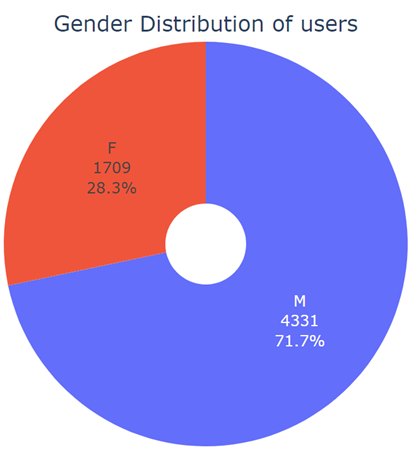

-	Maximum users are in 25-34 age group followed by 35-44 and 18-24

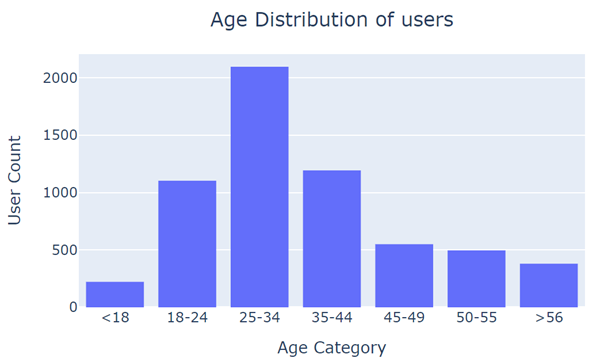

-	college students, executive/managerial level employees and educators are highest number of people who rated movies

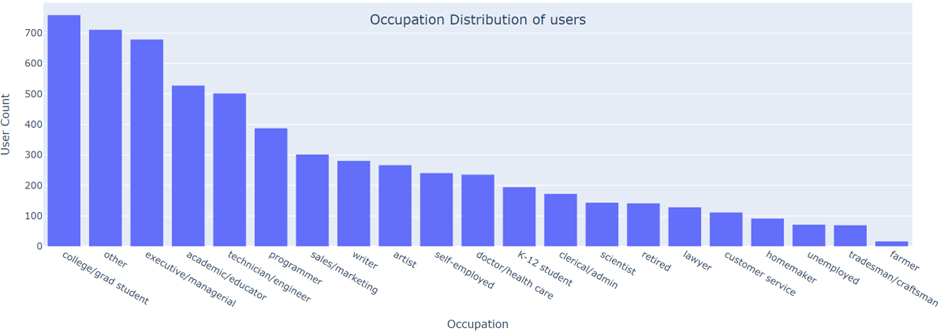

-	Maximum number of users are from California

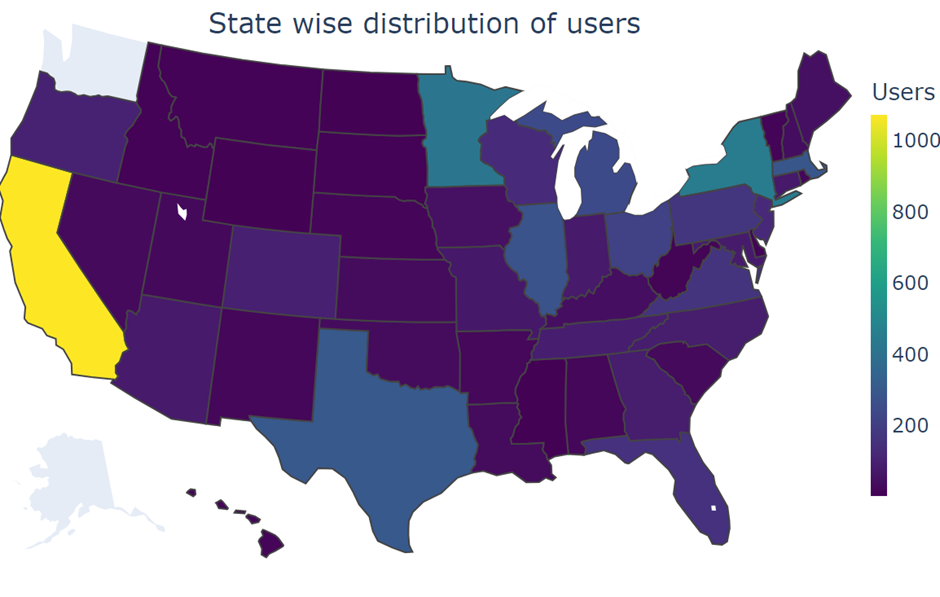

Movie Analysis
-	Maximum number of movies are drama genre followed by comedy movies. Fantasy, western and film-noir are minimum genre

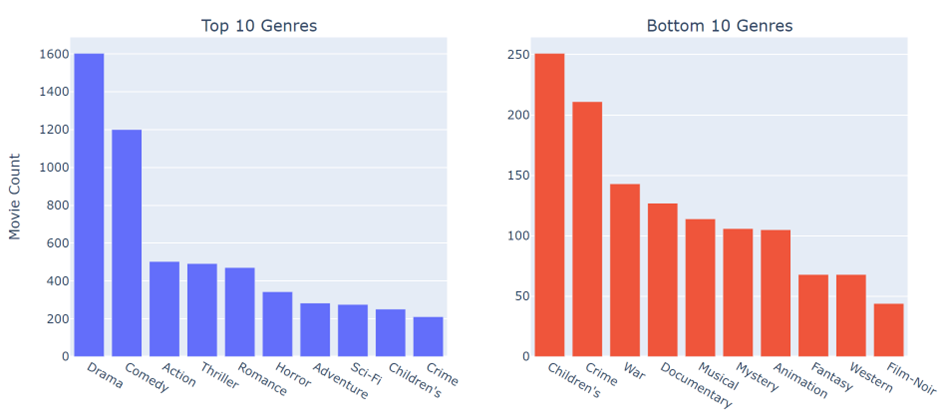

-	60% of the movies are released in 90’s decade

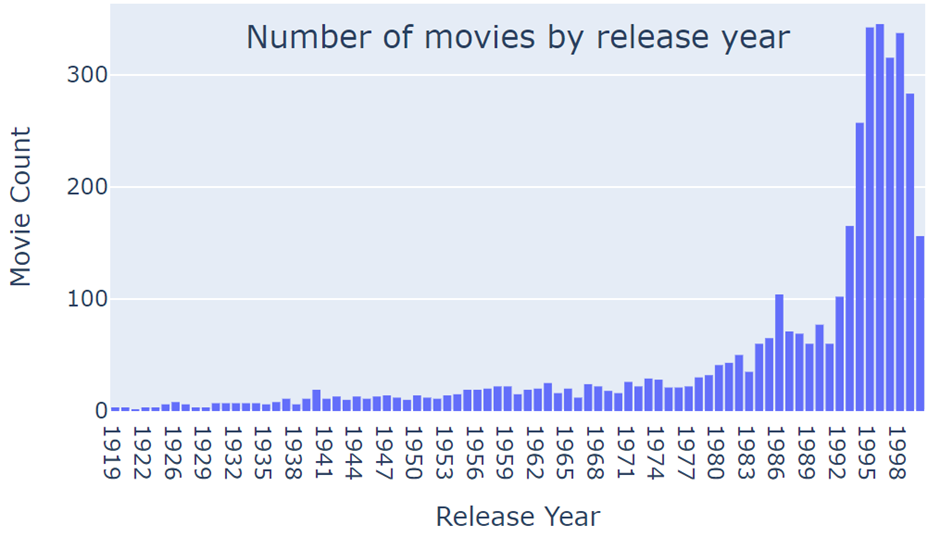

Rating Analysis

-	Mean and Median rating is 3.58 and 4.0 respectively

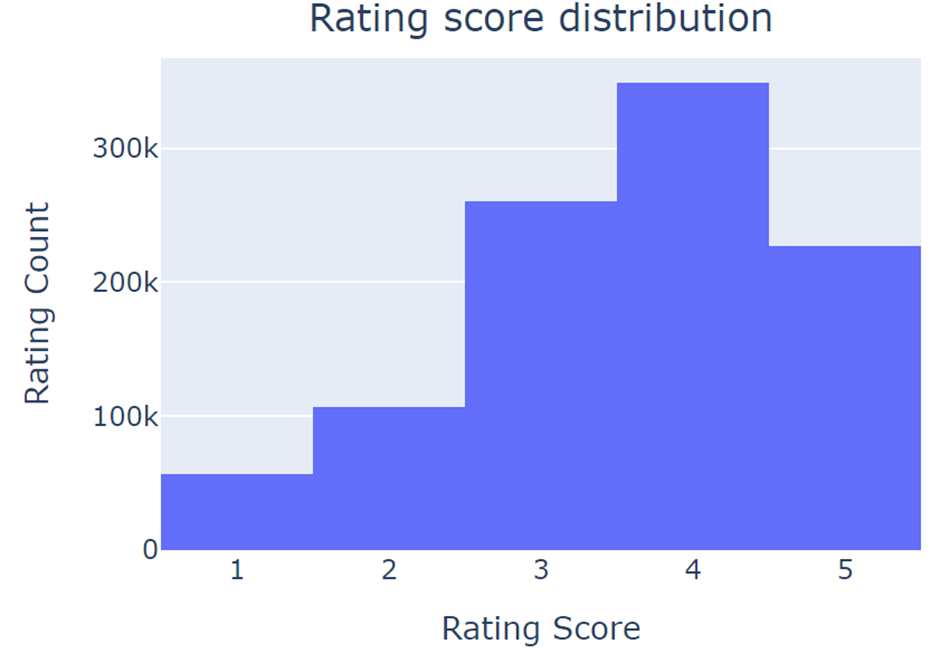

-	Most of the ratings were given in the year 2000
-	Highest ratings are given in the month November or on Monday

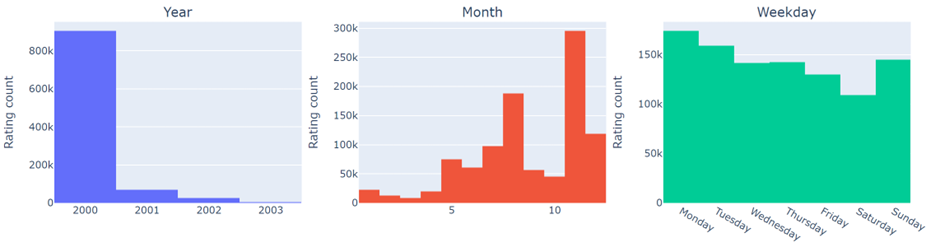

-	All the users rated at least 20 movies and all the movies got rated at least once

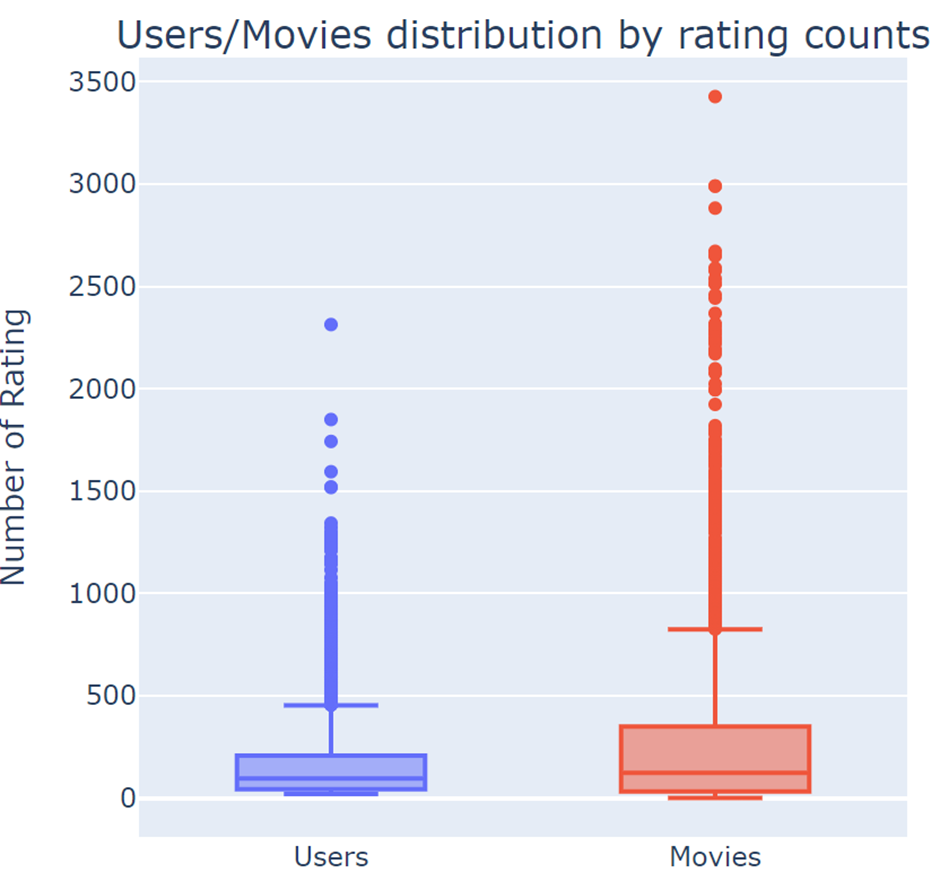

-	Drama and Comedy movies are given maximum number of ratings and higher ratings.

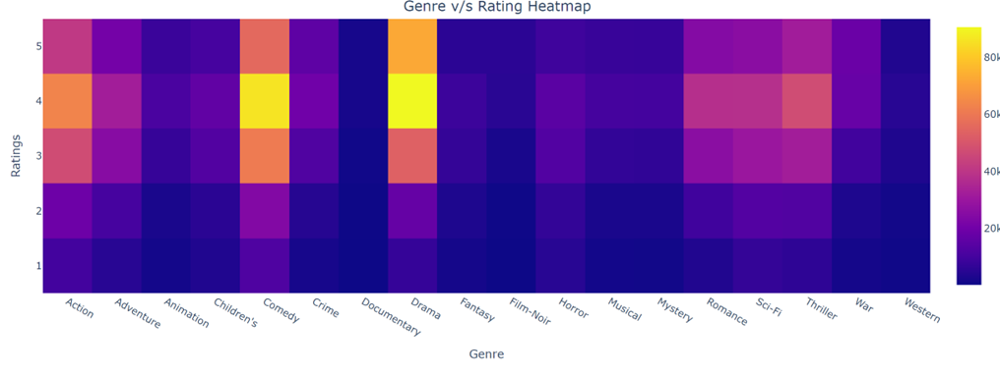

-	Sunburst plot for age and rating pair

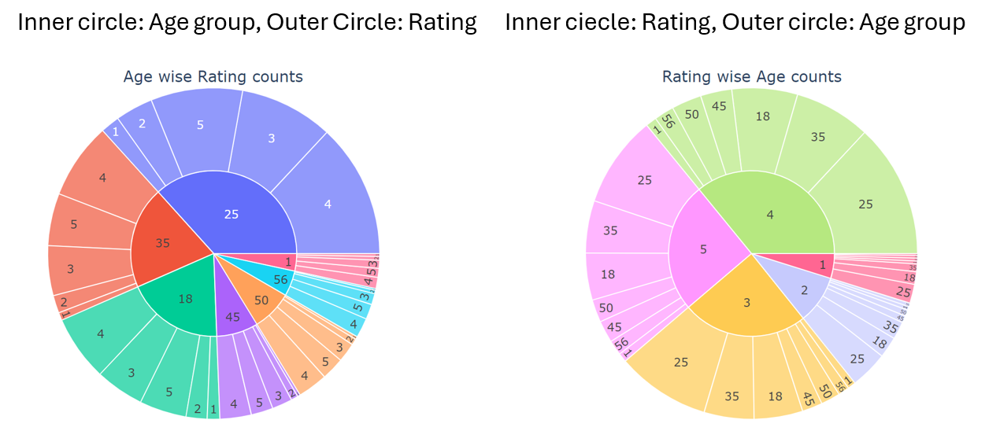

**Hypothesis testing**

ANOVA test results for mean rating various categorical columns are as follows

1. ANOVA test statistic value for Age is 521.2577856487302 and pvalue is 0.0
<br>  We reject H0 and At least one Age have different mean rating
2. ANOVA test statistic value for Gender is 94.27 and pvalue is 2.76e-22
<br>  We reject H0 and At least one Gender have different mean rating
3.	ANOVA test statistic value for Occupation is 69.14 and pvalue is 1.10e-280
<br>  We reject H0 and At least one Occupation have different mean rating
4.	ANOVA test statistic value for RatingYear is 24.99 and pvalue is 3.63e-16
<br>  We reject H0 and At least one RatingYear have different mean rating
5.	ANOVA test statistic value for RatingMonth is 24.68 and pvalue is 8.92e-52
<br>  We reject H0 and At least one RatingMonth have different mean rating
6.	ANOVA test statistic value for Genres is 1402.26 and pvalue is 0.0
<br>  We reject H0 and At least one Genres have different mean rating

χ2 test of independence for various combinations are as follows

1.	Chi-square statistic value is 161.79 and pvalue is 6.04e-34
<br>  We reject H0 and Rating and Gender are not independent
2.	Chi-square statistic value is 4212.96 and pvalue is 0.0
<br>  We reject H0 and Rating and Age group are not independent
3.	Chi-square statistic value is 19835.57 and pvalue is 0.0
<br>  We reject H0 and Genre and Age group are not independent
4.	Chi-square statistic value is 25992.88 and pvalue is 0.0
<br>  We reject H0 and Genre and Rating are not independent
5.	Chi-square statistic value is 26487.59 and pvalue is 0.0
<br>  We reject H0 and Genre and Gender are not independent


**Anomaly detection and removal**
-	From the box plot of movie counts rated by each user, it is evident that some users rated very high number of movies which is practically impossible and should be treated as outliers. 475 users who rated more than 454 movies should be dropped before training the model.

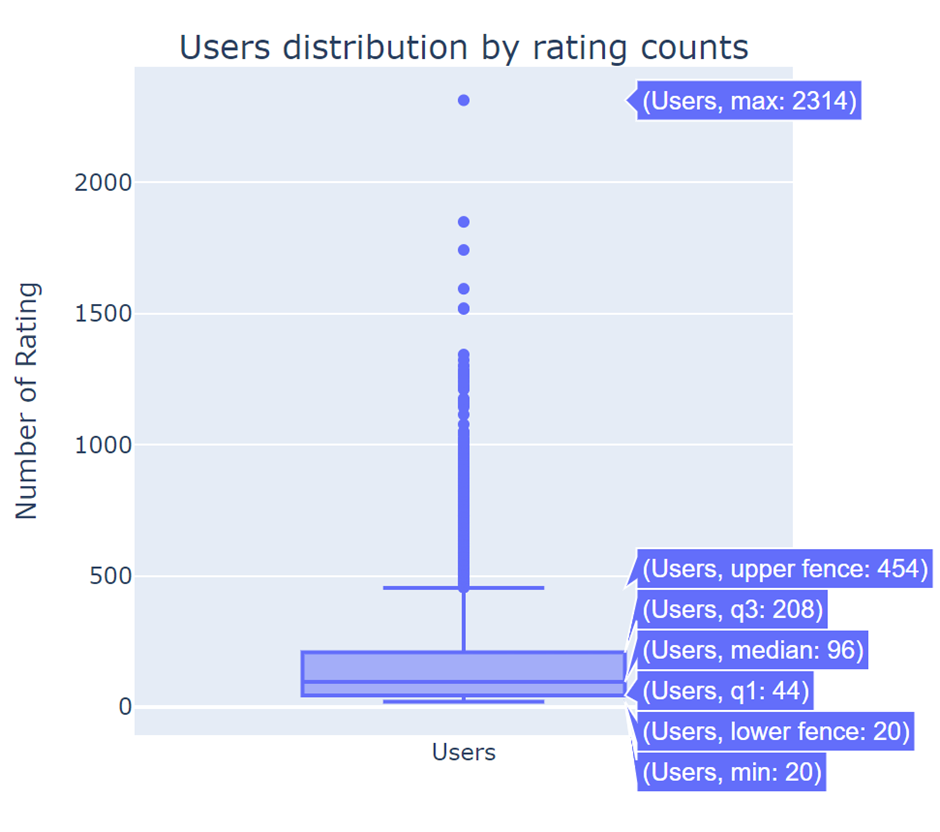

---
**Data preparation for modelling**
-	Interaction_Matrix is created by transforming ratings table with the help of `df.pivot_table()` method
-	Sparsity of the interaction_matrix is 0.0335 or 3.350%
-	Further data splitting was done as train and test data by the ratio 80:20


---
**Recommender System based on similarity score**
-	Person correlation based item-item similarity matrix (`item_pearson_similarity`) is created from the test data with the help of pandas `pd.corr()` method
-	Cosine similarity matrix (`item_cosine_similarity`) is calculated with scikit-learn standard library `sklearn.metrics.pairwise.cosine_similarity`
-	For given user movie ratings are predicted from item-item similarity matrix for unrated movies with the formula:

$$ \hat{r}_{ui} = \frac{\sum_{j\in{N_u}}{sim(i,j) \cdot r_{ui}}}{\sum_{j\in{N_u}}{|sim(i,j)|}} $$

>>Where:
* $N_u$: Items rated by user $u$
* $sim(i,j)$: Similarity between items $i$ and $j$
* $r_uj$: Rating by user $u$ for item $j$

-	After making predictions, 10 randomly selected movies are suggested from ratings predicted higher than 3.5 or from top 30 movies.
-	Model performance for Pearson Correlation Recommendation model

Metrics|Train Data|Test Data
-|-|-
RMSE|	1.29|	1.30
MAPE|	34.84%|	34.80%

-	Model performance for Cosine Similarity Recommendation model

Metrics|Train Data|Test Data
-|-|-
RMSE|	1.17|	1.18
MAPE|	34.23%|	34.28%

-	Performance with cosine similarity is slightly better compared to pearson correlation but not a significant improvement


---
**Matrix Factorization recommendation system**
-	Collective Matrix Factorization (CMF) from `cmfrec` library is used to factorize rating matrix into `user_embadding` and `item_embedding` and then these two embedding vector matrices are used to predict the ratings given by users to unrated movies
-	**Hyperparameter tuning:** Number of features (`k`) is hyperparameter for CMF models and below chart is `MSE` and `MAPE` scores for various values of `k`


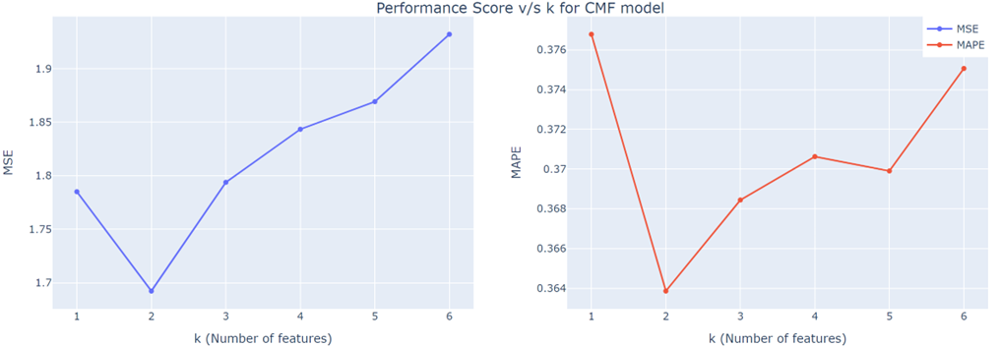

* From chart it is evident that best performance is achieved at k=2 and final model to be built with two features
* **Recommendation:** Top n number of item (movie) recommendations are obtained by method `model.topN(user=UserID, n=n)` where movies already rated/watched by user need to be filtered out and remaining can be recommended to user.
* **Rating Prediction:** rating for given user and item (movie) combination is predicted with formula $X=AB^T+μ +b_A+b_B$

  Where:<br>
    $A$ = user matrix (`model.A_`)<br>
    $B^T$ = item matrix (`model.B_`)<br>
    $μ$ = average rating (`model.glob_mean_`)<br>
    $b_A$ = user specific bias<br>
    $b_B$ = item specific bias<br>

-	If predicted rating is not between 1 to 5 then lower value is clipped to 1 and upper value is clipped to 5

---
**Summary**
-	Recommender system can enhance user experience on the platform and increase user engagement rate.
-	Personalised recommendation feature can be game changer in pulling new users and retain existing users.
-	Another metric should be added on platform to identify how many users are consuming content from recommendations which can help to build more reliable recommendation system.
